# В данном ноутбуке рассматривается пример генеративно-состязательных сетей (GAN)

А если точнее, то глубокая сверточная генеративно-состязательная сеть (DCGAN)

В отличае от VAL они создают ОДИН кадр изображения, но оно получается супер-реалистичным.

Суть заключается в том, что есть сеть-генератор, которая берет точку из пространства скрытых представлений, проецирует ее в изображение, сеть-дискриминатор получает это изображение и пытается понять, реально ли оно, или было созданогенератором. Генератор учится создавать все более правдоподобные изображения, а дискриминатор - определеять все более лучшую подделку.

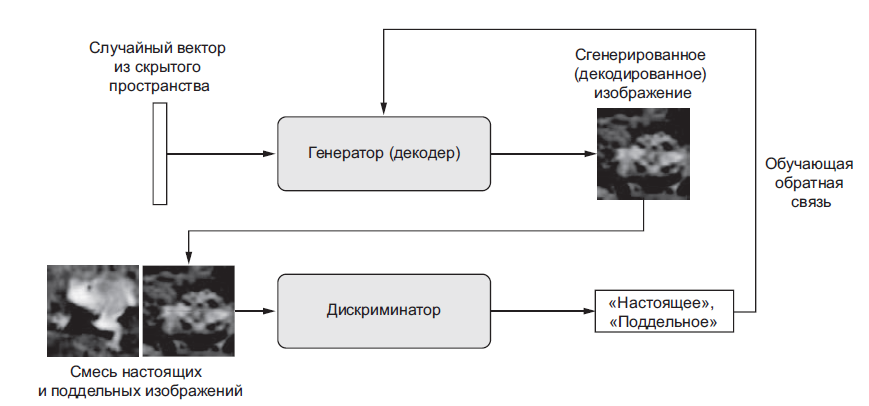

В GAN процесс оптимизации стремится не к минимуму функции потерь, а к равной "силе" обеих сетей.

GAN требуют больших усилий для настройки гиперпараметров.

В общих чертах суть будет такая:
* сеть generator отображает точки из скрытого пространства в изображения (32, 32, 3) из датасета CIFAR-10
* сеть discriminator отображает изображения в оценку вероятности того, является ли изображение настоящим
* сеть gan объединяет их: gan = discriminator(generator)
* discriminator обучается на изображених и метках: "настоящее", "подделка"
* веса generator будут смещаться в направлении увеличения вероятности классификации discriminator изображений как "настоящих"

# Создание сети - генератора

In [ ]:
import keras
from keras import layers
from keras.models import Model
import numpy as np

dimensions = 32
height = 32
width = 32
channels = 3

generator_input = keras.Input(shape=(dimensions,))


x = layers.Dense(128 * 16 * 16)(generator_input)
# слой LeakyReLu напоминает обычный ReLu, но снижает ограничение разреженности, 
# допуская небольшие отрицательные значения активации
x = layers.LeakyReLU()(x)
# преобразлование входа в карту признаков с 16x16 со 128 каналами
x = layers.Reshape((16, 16, 128))(x)

# увеличение разрешения до 32х32
x = layers.Conv2D(256, 5, padding='same')(x)
x = layers.LeakyReLU()(x)

x = layers.Conv2DTranspose(256, 4, strides=2, padding='same')(x)
x = layers.LeakyReLU()(x)

# в GAN вместо relu стоит использовать tanh
x = layers.Conv2D(channels, 7, activation='tanh', padding='same')(x)
generator = Model(generator_input, x)
generator.summary()

# ГЕНЕРАТОР НЕ КОМПИЛИРУЕМ???

Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 32)]              0         
_________________________________________________________________
dense_2 (Dense)              (None, 32768)             1081344   
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 32768)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 16, 16, 256)       819456    
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 16, 16, 256)       0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 32, 32, 256)      

# Создание сети-дискриминатора

In [ ]:
discriminator_input = keras.Input(shape=(height, width, channels))
x = layers.Conv2D(128, 3)(discriminator_input)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(128, 4, strides=2)(x)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(128, 4, strides=2)(x)
x = layers.LeakyReLU()(x)
x = layers.Conv2D(128, 4, strides=2)(x)
x = layers.LeakyReLU()(x)
x = layers.Flatten()(x)

# GAN могут застревать на некоторых местах, для этого нужно ввести элемент
# стохастичности в тренировку
# один из методов - прореживание
x = layers.Dropout(0.4)(x)

# в самом последнем слое дискриминатора стоит использовать сигмоиду
x = layers.Dense(1, activation='sigmoid')(x)

discriminator = Model(discriminator_input, x)
discriminator.summary()

discriminator_optimizer = keras.optimizers.RMSprop(
    lr=0.0008,
    # использование градиентной обрезки (по значению) в оптимизаторе
    clipvalue=1.0,
    # для стабилизации используется затухание скорости обучения
    decay=1e-8
)

discriminator.compile(optimizer=discriminator_optimizer, loss='binary_crossentropy')

Model: "functional_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 32, 32, 3)]       0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 30, 30, 128)       3584      
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 30, 30, 128)       0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 14, 14, 128)       262272    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 14, 14, 128)       0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 6, 6, 128)         262272    
_________________________________________________________________
leaky_re_lu_12 (LeakyReLU)   (None, 6, 6, 128)        

# Создание состязательной сети

In [ ]:
# gan будет смещать в генераторе веса так, чтобы максимизировать вероятность
# результата "настоящая" в дискриминаторе

# на время обучения gan дискриминатор надо заморозить, чтобы его веса не менялись
# это происходит имеено в gan, а не глобально
discriminator.trainable = False

gan_input = keras.Input(shape=(dimensions,))
# объединение двух сетей
gan_output = discriminator(generator(gan_input))
gan = Model(gan_input, gan_output)

gan_optimizer = keras.optimizers.RMSprop(
    lr=4e-4,
    clipvalue=1.0,
    decay=1e-8
)
gan.compile(optimizer=gan_optimizer, loss='binary_crossentropy')

# Как обучать GAN
* Извлечь случайные точки из пространства представлений
* Генератором создать изображение
* СМЕШАТЬ сгенерированное и реальное изображение
* Обучить ДИСКРИМИНАТОР на смешанном наборе с целями "настоящее" и "подделка" соответственно
* Выбрать НОВЫЕ случайные точки из пространства представлений
* Обучить GAN на только что полученных точках с целыми "НАСТОЯЩЕЕ" 
(так веса генератора сместятся, чтобы он мог обмануть дискриминатор)

Примечательно, что генератор вообще не видит изображения из обучающего набора. Все что он видит - поступает из дискриминатора.

# Реализация обучения GAN

discriminator loss: 0.6713603734970093
generator loss: 0.6329217553138733
Generated image (step 0)


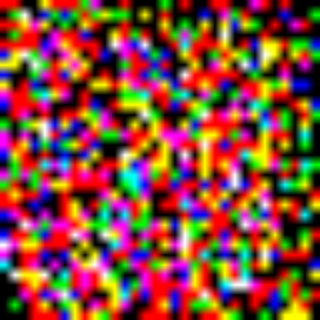

Real image (step 0)


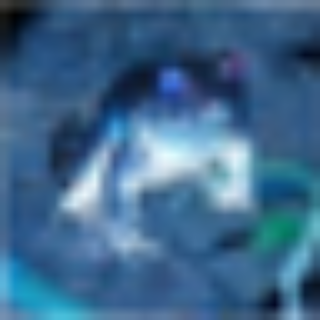

discriminator loss: 0.6779491305351257
generator loss: 0.4676167070865631
Generated image (step 100)


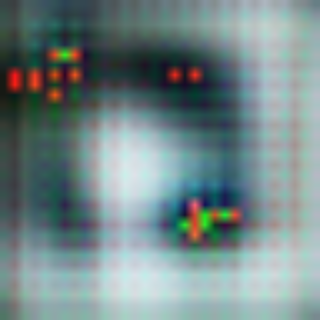

Real image (step 100)


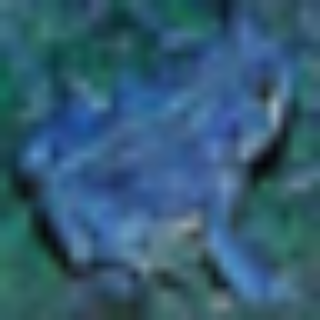

discriminator loss: 0.6823362112045288
generator loss: 0.7941082715988159
Generated image (step 200)


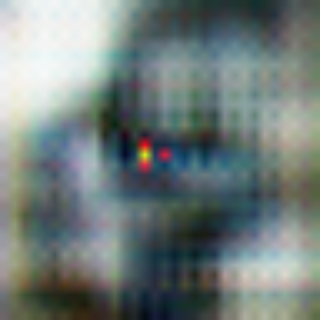

Real image (step 200)


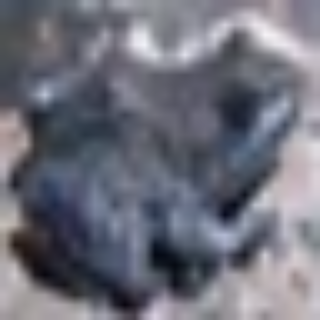

discriminator loss: 0.6868845820426941
generator loss: 0.7899876832962036
Generated image (step 300)


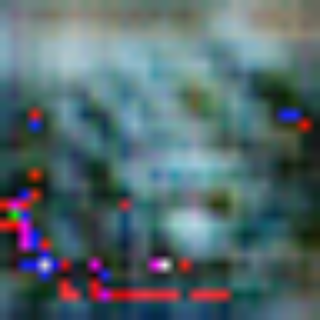

Real image (step 300)


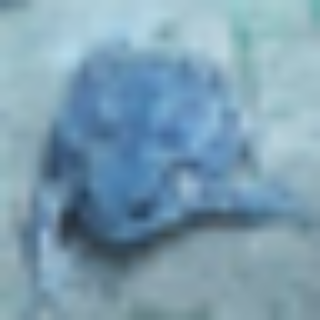

discriminator loss: 0.7026903033256531
generator loss: 0.7254263758659363
Generated image (step 400)


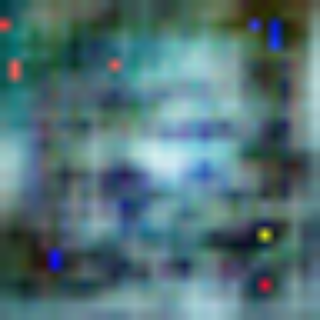

Real image (step 400)


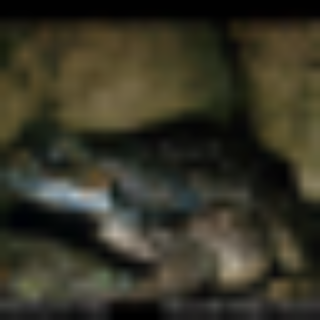

discriminator loss: 0.703105092048645
generator loss: 0.7687063217163086
Generated image (step 500)


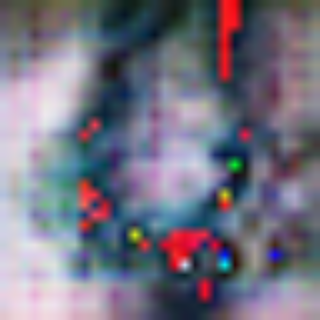

Real image (step 500)


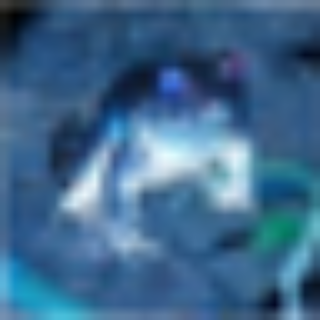

discriminator loss: 0.6830867528915405
generator loss: 0.7705066800117493
Generated image (step 600)


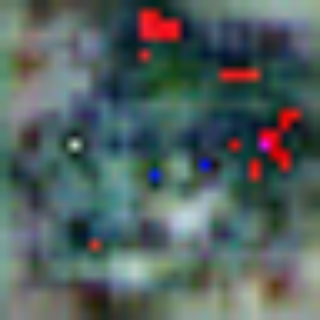

Real image (step 600)


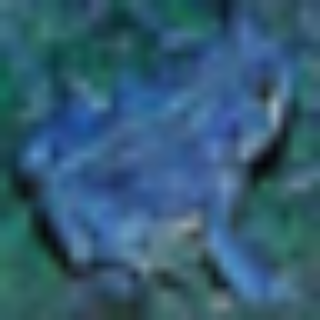

discriminator loss: 0.6895908713340759
generator loss: 0.7498055696487427
Generated image (step 700)


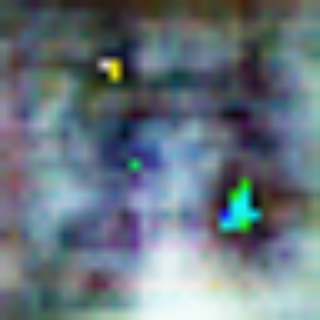

Real image (step 700)


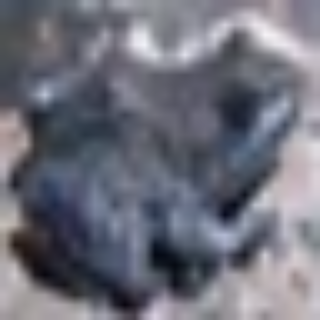

discriminator loss: 0.7127794027328491
generator loss: 0.7188977003097534
Generated image (step 800)


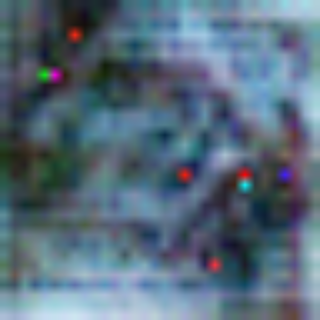

Real image (step 800)


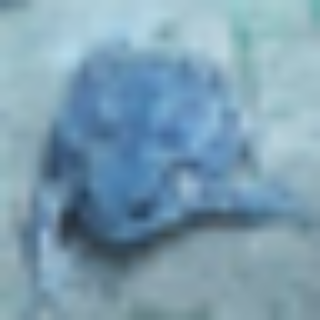

discriminator loss: 0.6915093660354614
generator loss: 0.7601364254951477
Generated image (step 900)


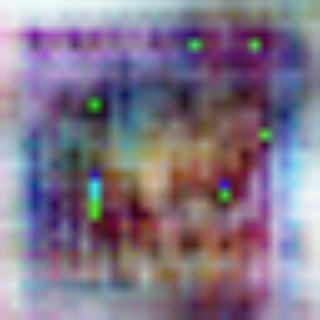

Real image (step 900)


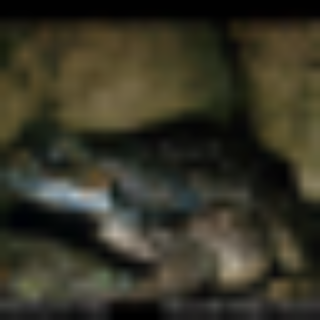

discriminator loss: 0.7054769396781921
generator loss: 0.7569591403007507
Generated image (step 1000)


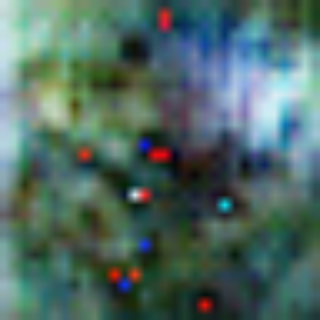

Real image (step 1000)


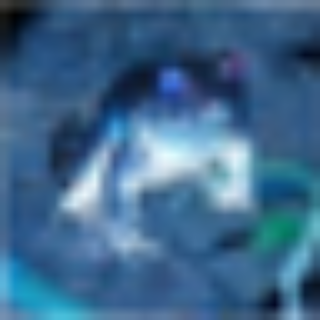

discriminator loss: 0.6981595754623413
generator loss: 0.7353761792182922
Generated image (step 1100)


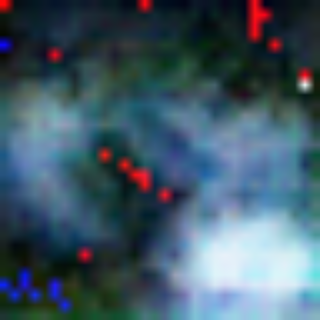

Real image (step 1100)


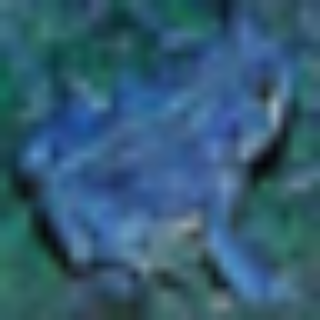

discriminator loss: 0.6910734176635742
generator loss: 0.7524110078811646
Generated image (step 1200)


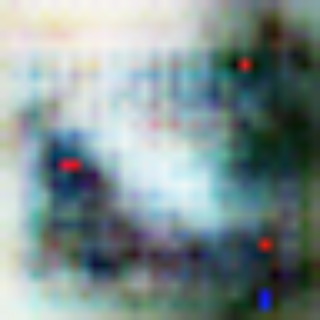

Real image (step 1200)


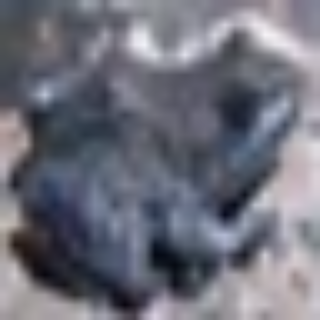

discriminator loss: 0.6889458894729614
generator loss: 0.8335310220718384
Generated image (step 1300)


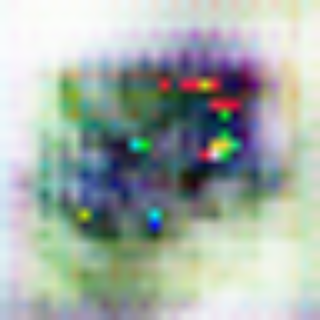

Real image (step 1300)


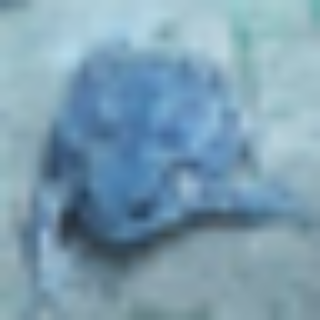

discriminator loss: 0.6916855573654175
generator loss: 0.7452155947685242
Generated image (step 1400)


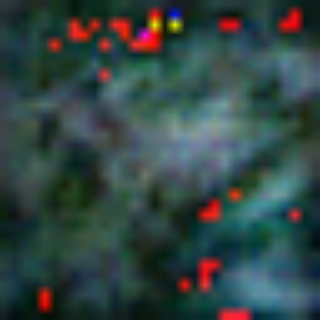

Real image (step 1400)


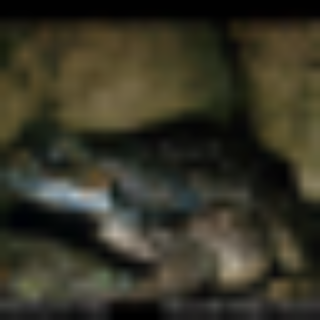

discriminator loss: 0.6951719522476196
generator loss: 0.6457706689834595
Generated image (step 1500)


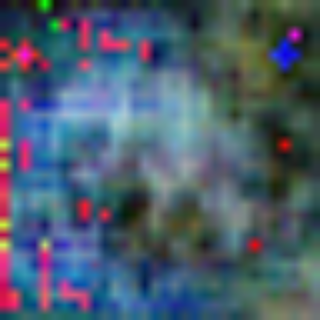

Real image (step 1500)


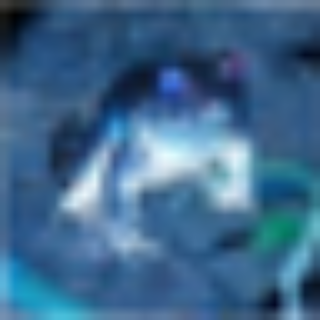

discriminator loss: 0.6959539651870728
generator loss: 0.7523234486579895
Generated image (step 1600)


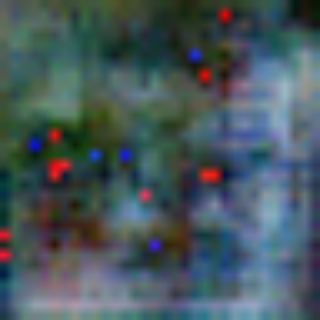

Real image (step 1600)


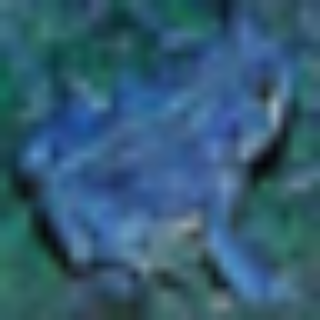

discriminator loss: 0.7053991556167603
generator loss: 0.7635242938995361
Generated image (step 1700)


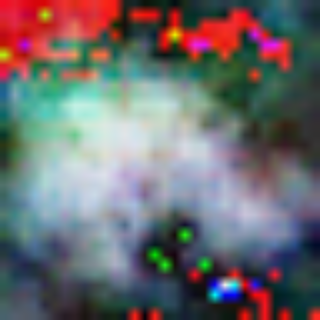

Real image (step 1700)


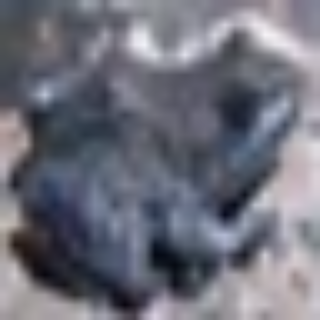

discriminator loss: 0.6990073919296265
generator loss: 0.718114972114563
Generated image (step 1800)


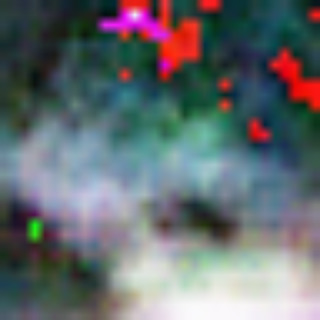

Real image (step 1800)


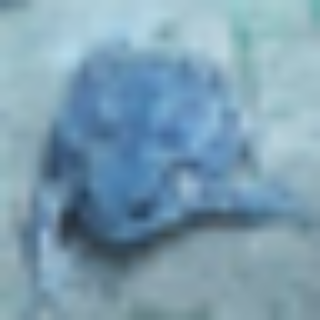

discriminator loss: 0.698768138885498
generator loss: 0.7934504747390747
Generated image (step 1900)


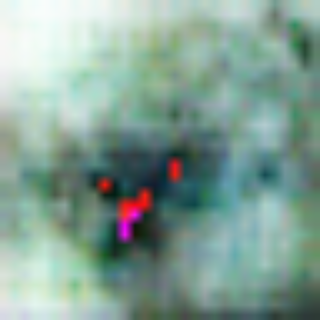

Real image (step 1900)


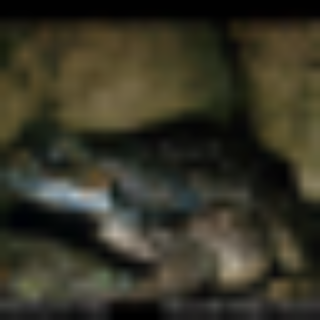

discriminator loss: 0.7019803524017334
generator loss: 0.7640379071235657
Generated image (step 2000)


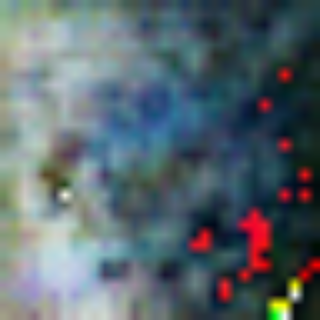

Real image (step 2000)


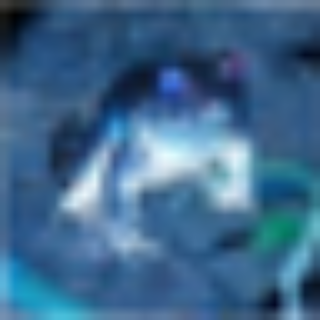

discriminator loss: 0.7064967751502991
generator loss: 0.7508577704429626
Generated image (step 2100)


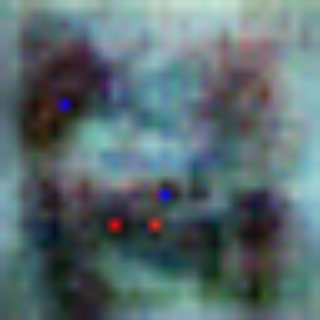

Real image (step 2100)


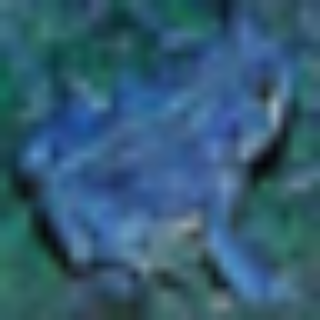

discriminator loss: 0.6887025237083435
generator loss: 0.735186755657196
Generated image (step 2200)


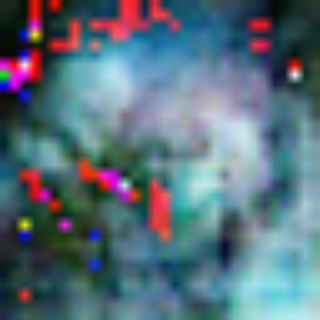

Real image (step 2200)


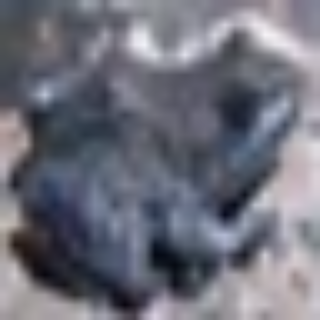

discriminator loss: 0.7000434994697571
generator loss: 0.8460191488265991
Generated image (step 2300)


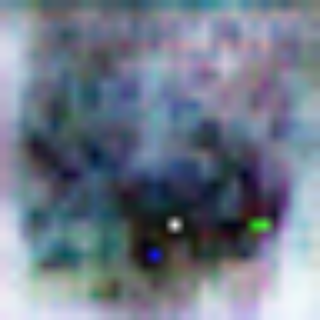

Real image (step 2300)


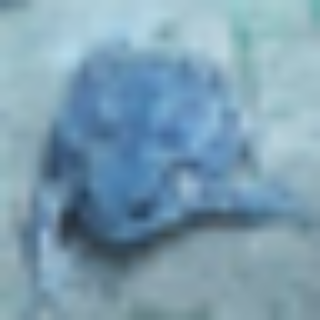

discriminator loss: 0.6947025060653687
generator loss: 0.7438002824783325
Generated image (step 2400)


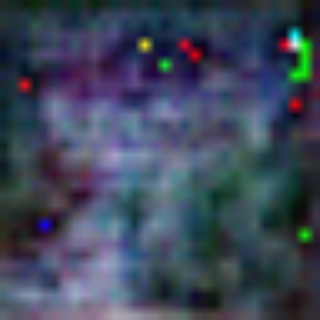

Real image (step 2400)


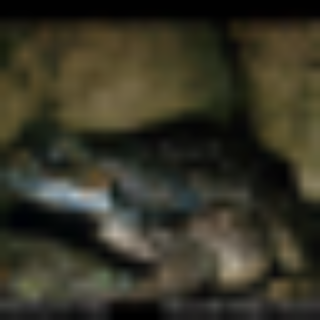

discriminator loss: 0.7098801732063293
generator loss: 0.7818630933761597
Generated image (step 2500)


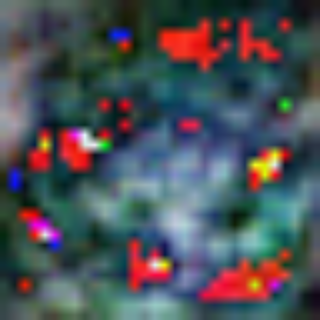

Real image (step 2500)


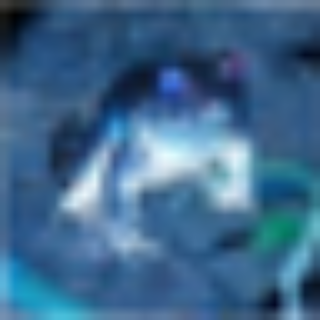

discriminator loss: 0.6910051703453064
generator loss: 0.7543344497680664
Generated image (step 2600)


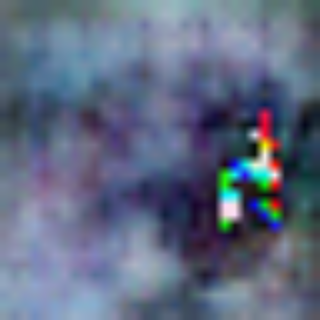

Real image (step 2600)


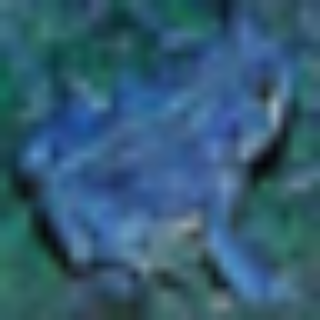

discriminator loss: 0.6871013045310974
generator loss: 0.7575157880783081
Generated image (step 2700)


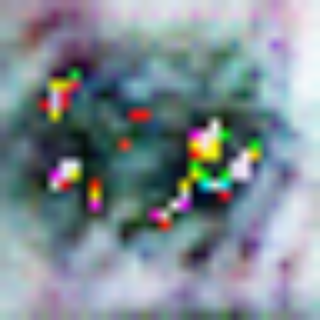

Real image (step 2700)


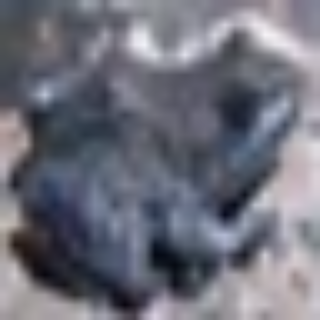

discriminator loss: 0.7046250104904175
generator loss: 0.7548317909240723
Generated image (step 2800)


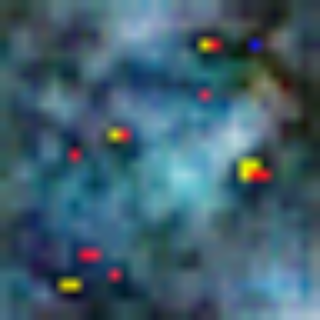

Real image (step 2800)


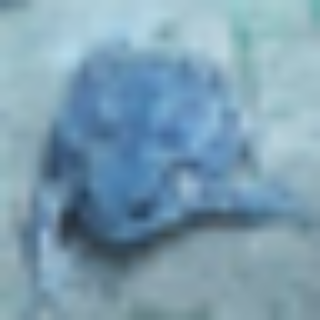

discriminator loss: 0.6937717199325562
generator loss: 0.7300130724906921
Generated image (step 2900)


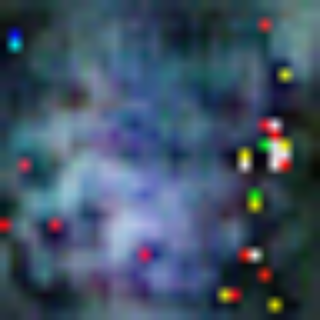

Real image (step 2900)


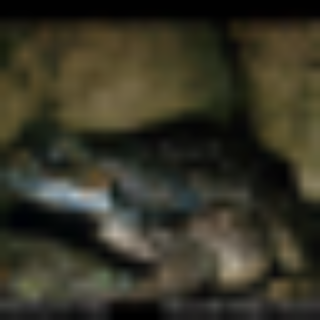

discriminator loss: 0.704239547252655
generator loss: 0.7387377023696899
Generated image (step 3000)


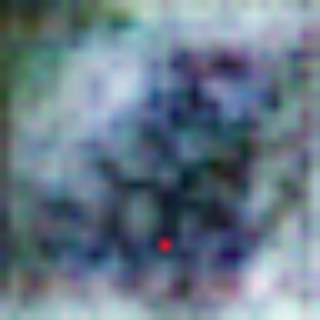

Real image (step 3000)


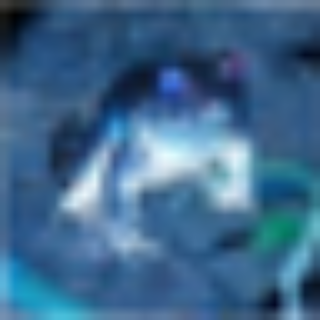

discriminator loss: 0.7386699914932251
generator loss: 0.7675477862358093
Generated image (step 3100)


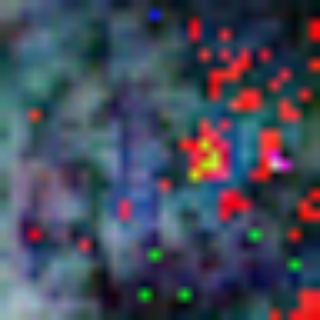

Real image (step 3100)


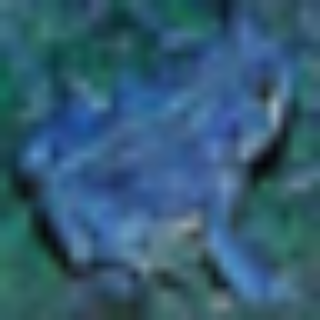

discriminator loss: 0.7056910395622253
generator loss: 0.7572246193885803
Generated image (step 3200)


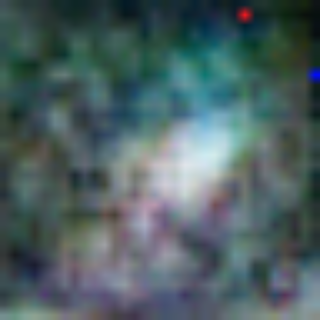

Real image (step 3200)


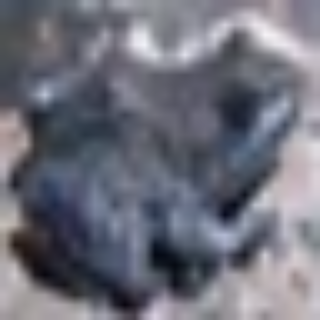

discriminator loss: 0.688332200050354
generator loss: 0.7477426528930664
Generated image (step 3300)


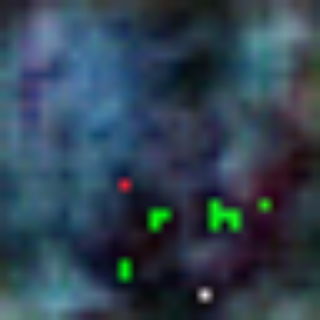

Real image (step 3300)


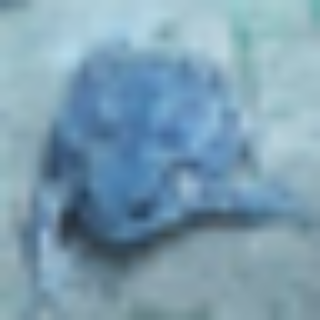

discriminator loss: 0.6998871564865112
generator loss: 0.7793909907341003
Generated image (step 3400)


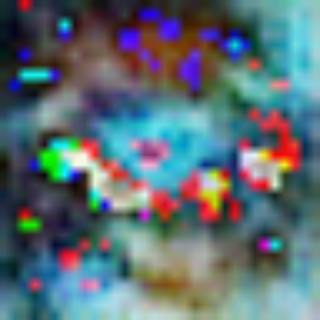

Real image (step 3400)


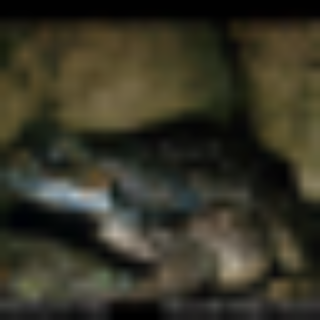

discriminator loss: 0.6993503570556641
generator loss: 0.7729746103286743
Generated image (step 3500)


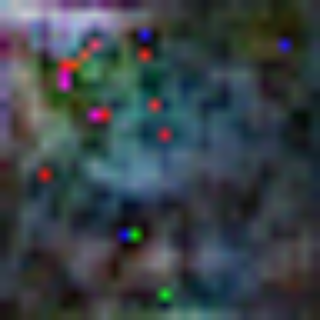

Real image (step 3500)


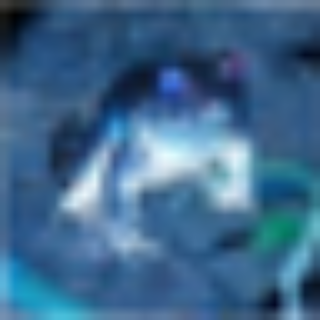

discriminator loss: 0.7027205228805542
generator loss: 0.7445318698883057
Generated image (step 3600)


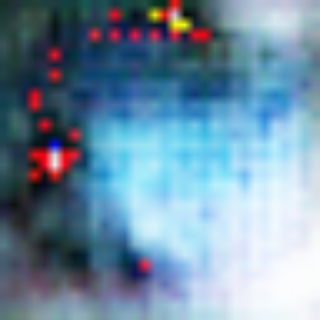

Real image (step 3600)


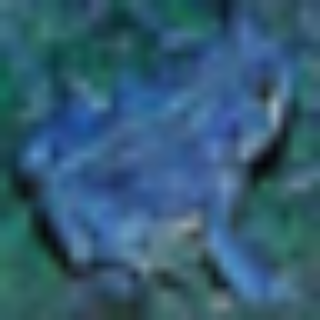

discriminator loss: 0.8675091862678528
generator loss: 0.788176417350769
Generated image (step 3700)


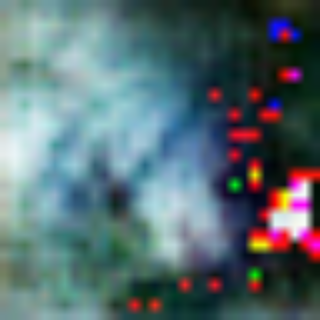

Real image (step 3700)


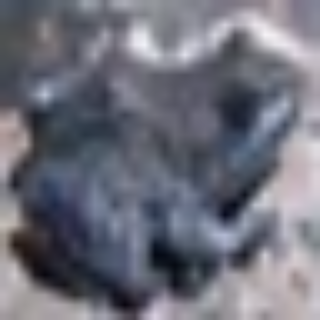

discriminator loss: 0.7198922634124756
generator loss: 0.7663527131080627
Generated image (step 3800)


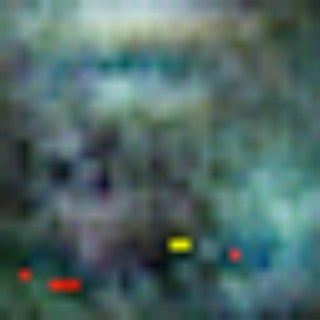

Real image (step 3800)


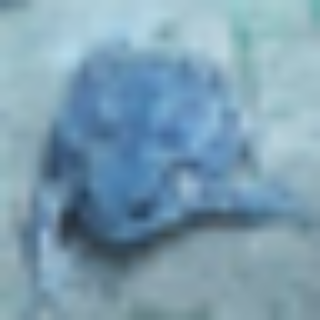

discriminator loss: 0.6873481273651123
generator loss: 0.7774091958999634
Generated image (step 3900)


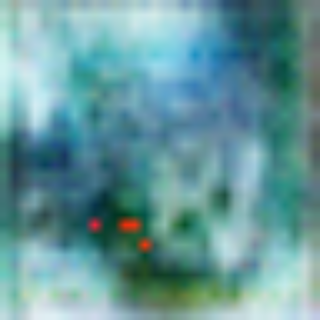

Real image (step 3900)


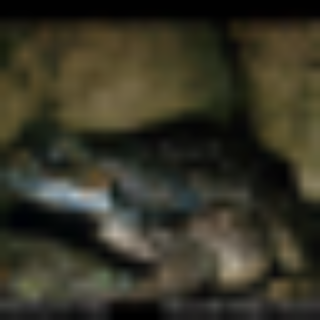

discriminator loss: 0.6966713666915894
generator loss: 0.783328652381897
Generated image (step 4000)


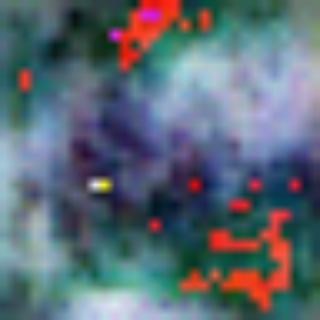

Real image (step 4000)


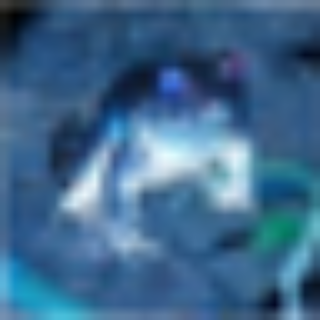

discriminator loss: 0.7045392990112305
generator loss: 0.725556492805481
Generated image (step 4100)


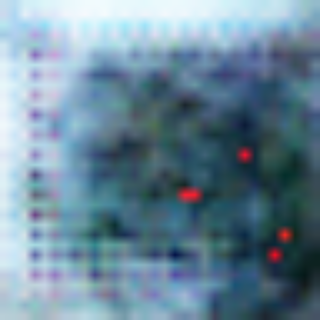

Real image (step 4100)


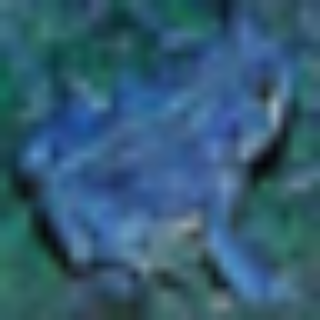

discriminator loss: 0.7222307324409485
generator loss: 0.7658802270889282
Generated image (step 4200)


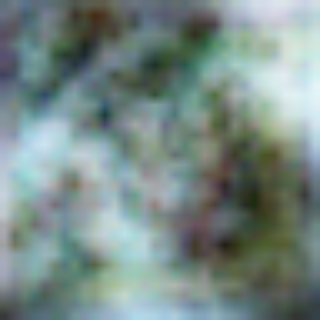

Real image (step 4200)


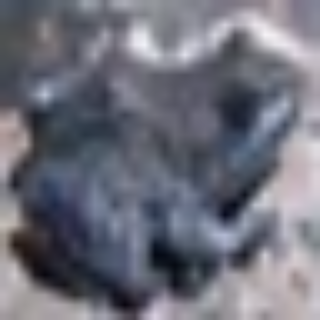

discriminator loss: 0.7059427499771118
generator loss: 0.6957688331604004
Generated image (step 4300)


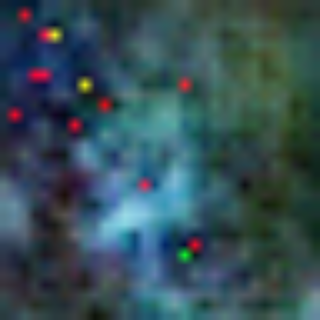

Real image (step 4300)


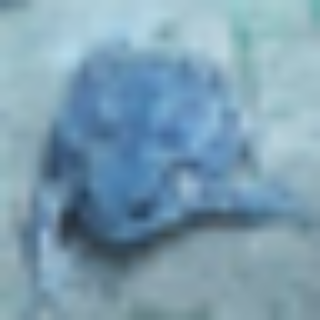

discriminator loss: 0.7102997899055481
generator loss: 0.6906381249427795
Generated image (step 4400)


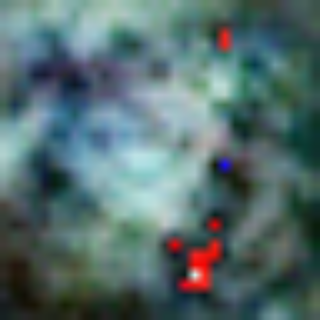

Real image (step 4400)


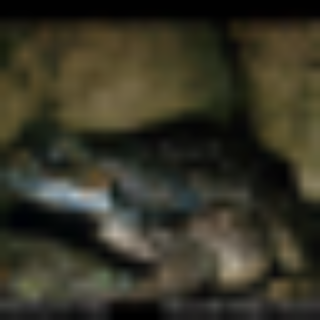

discriminator loss: 0.692345142364502
generator loss: 0.7390232086181641
Generated image (step 4500)


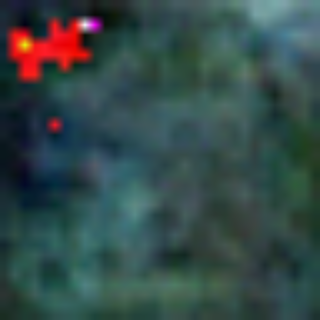

Real image (step 4500)


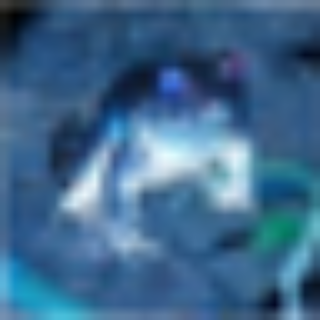

discriminator loss: 0.7020537257194519
generator loss: 0.7423669695854187
Generated image (step 4600)


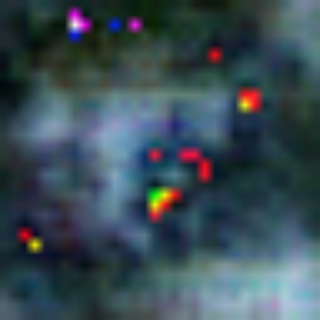

Real image (step 4600)


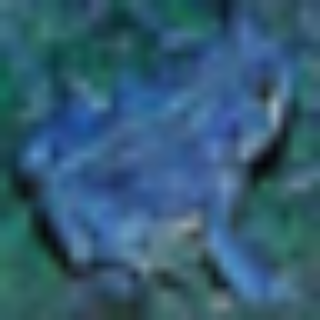

discriminator loss: 0.6959192752838135
generator loss: 0.796810507774353
Generated image (step 4700)


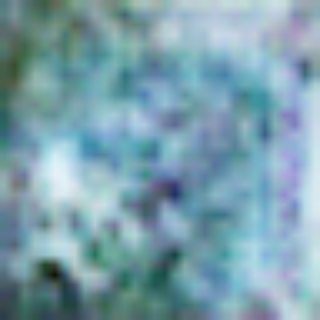

Real image (step 4700)


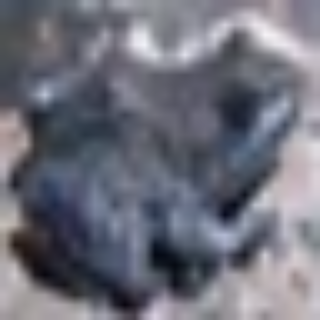

discriminator loss: 0.7002691030502319
generator loss: 0.7606717944145203
Generated image (step 4800)


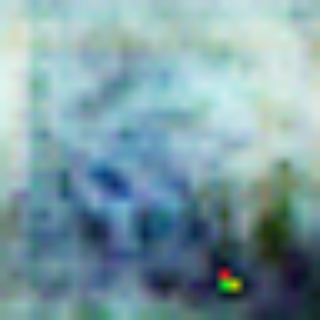

Real image (step 4800)


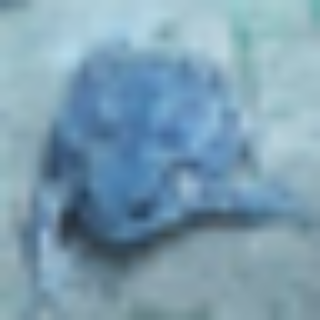

discriminator loss: 0.7024141550064087
generator loss: 0.7551358938217163
Generated image (step 4900)


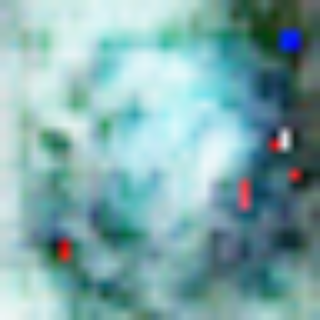

Real image (step 4900)


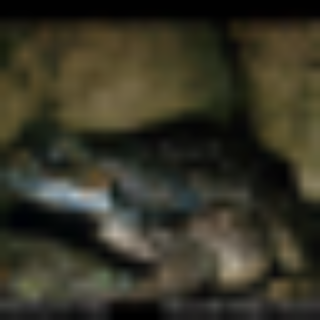

discriminator loss: 0.6999295949935913
generator loss: 0.7747541666030884
Generated image (step 5000)


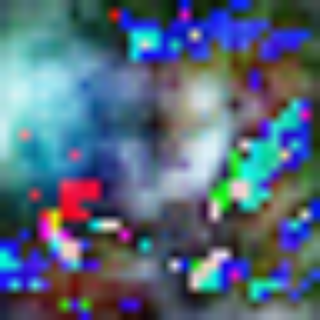

Real image (step 5000)


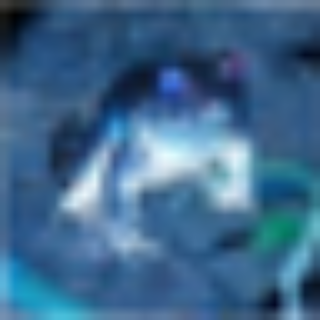

discriminator loss: 0.6837056875228882
generator loss: 0.7633780837059021
Generated image (step 5100)


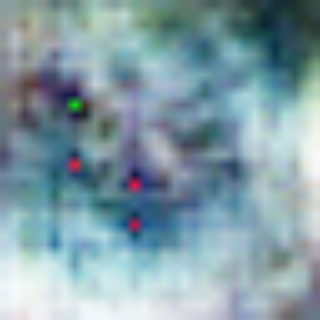

Real image (step 5100)


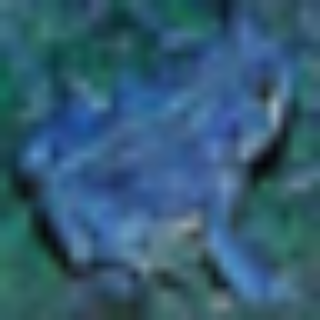

discriminator loss: 0.692732036113739
generator loss: 0.7396897673606873
Generated image (step 5200)


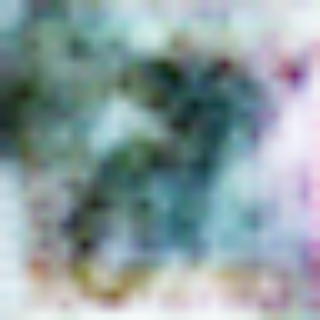

Real image (step 5200)


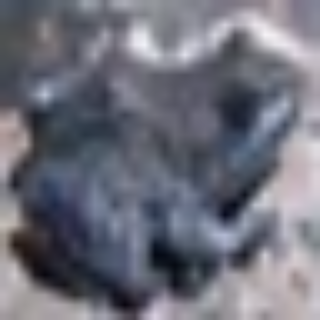

discriminator loss: 0.6854769587516785
generator loss: 0.7226255536079407
Generated image (step 5300)


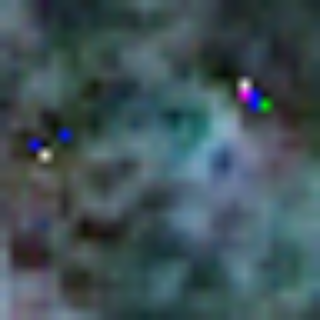

Real image (step 5300)


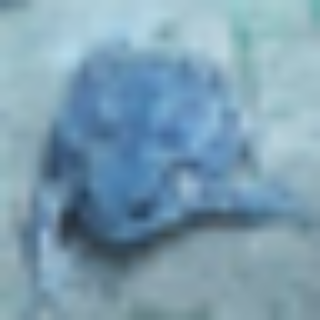

discriminator loss: 0.6816250085830688
generator loss: 0.9447738528251648
Generated image (step 5400)


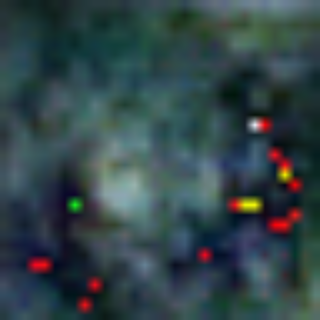

Real image (step 5400)


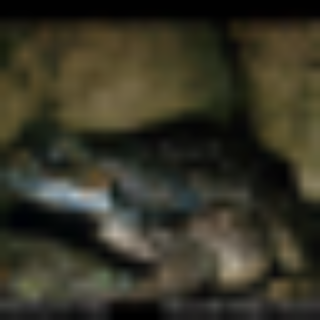

discriminator loss: 0.6826366186141968
generator loss: 0.7455965280532837
Generated image (step 5500)


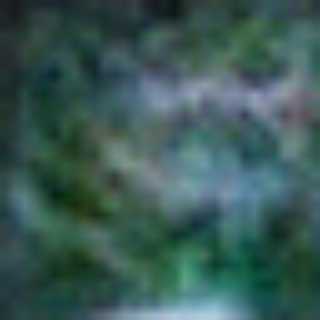

Real image (step 5500)


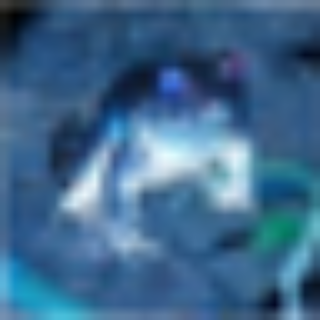

discriminator loss: 0.6979386210441589
generator loss: 0.7794016599655151
Generated image (step 5600)


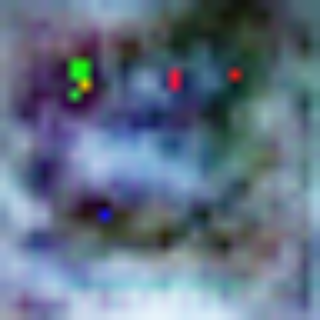

Real image (step 5600)


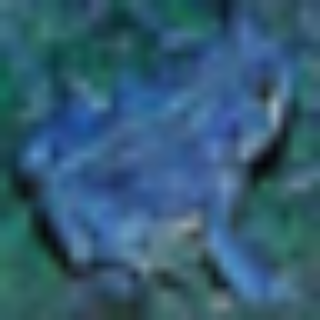

discriminator loss: 0.6890488862991333
generator loss: 0.7982183694839478
Generated image (step 5700)


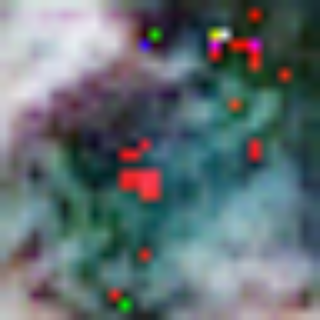

Real image (step 5700)


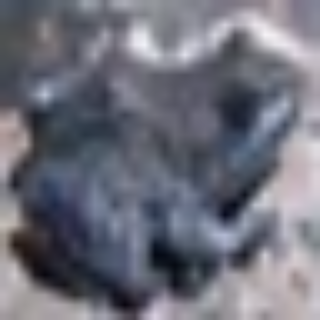

discriminator loss: 0.6926658749580383
generator loss: 0.7407334446907043
Generated image (step 5800)


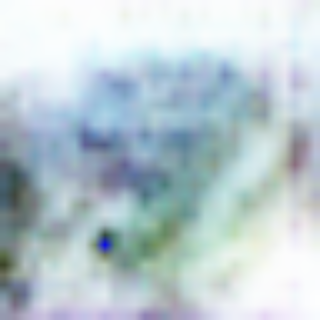

Real image (step 5800)


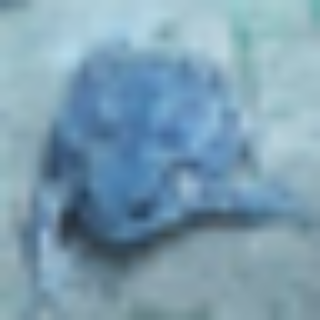

discriminator loss: 0.6912879943847656
generator loss: 0.7651026844978333
Generated image (step 5900)


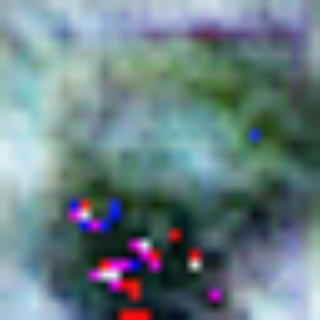

Real image (step 5900)


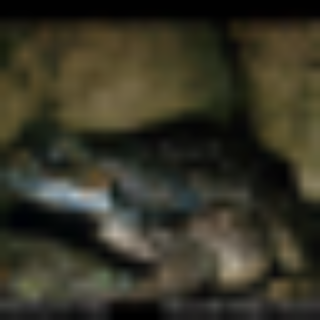

discriminator loss: 0.6878209710121155
generator loss: 0.7179698944091797
Generated image (step 6000)


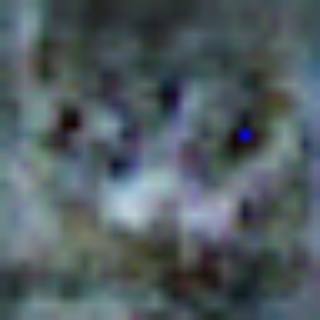

Real image (step 6000)


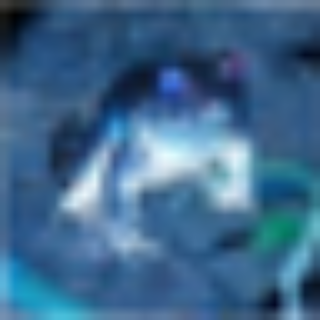

discriminator loss: 0.6901950240135193
generator loss: 0.7378985285758972
Generated image (step 6100)


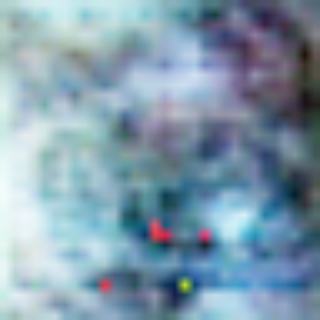

Real image (step 6100)


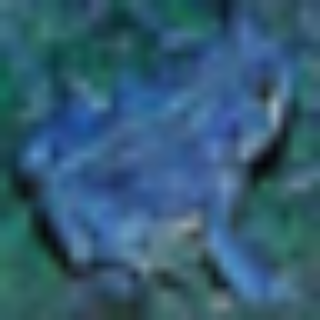

discriminator loss: 0.7046154737472534
generator loss: 0.7002058029174805
Generated image (step 6200)


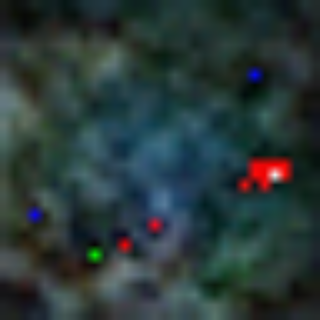

Real image (step 6200)


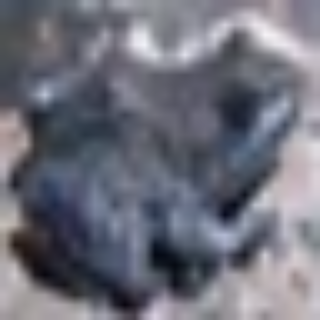

discriminator loss: 0.6923246383666992
generator loss: 0.7553289532661438
Generated image (step 6300)


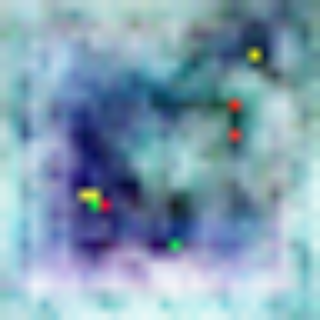

Real image (step 6300)


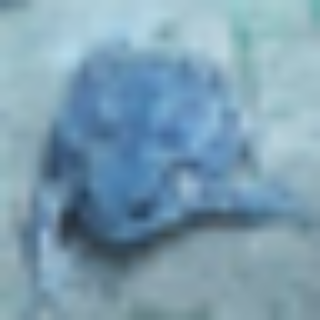

discriminator loss: 0.6912041306495667
generator loss: 0.5347544550895691
Generated image (step 6400)


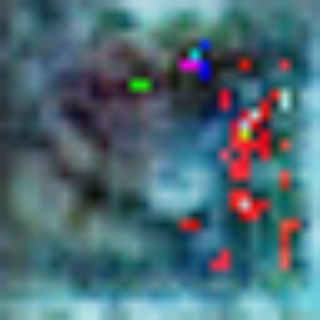

Real image (step 6400)


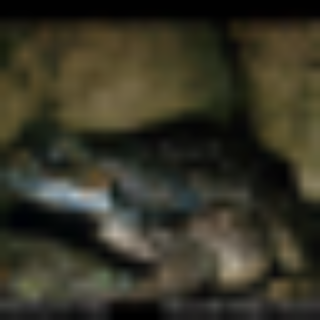

discriminator loss: 0.6910594701766968
generator loss: 0.7402032613754272
Generated image (step 6500)


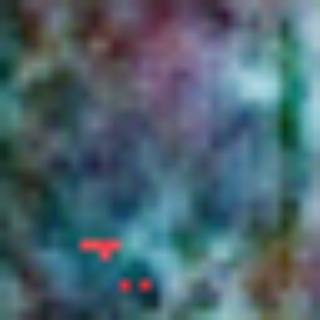

Real image (step 6500)


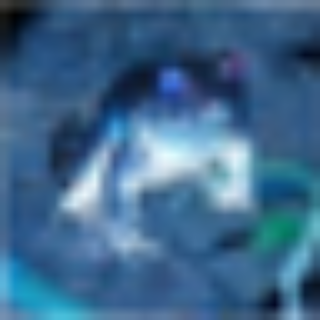

discriminator loss: 0.7067092657089233
generator loss: 0.7368502020835876
Generated image (step 6600)


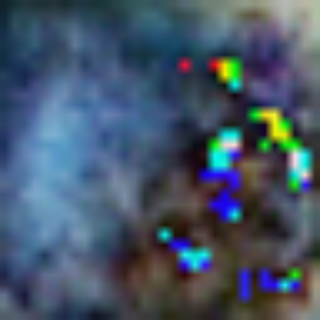

Real image (step 6600)


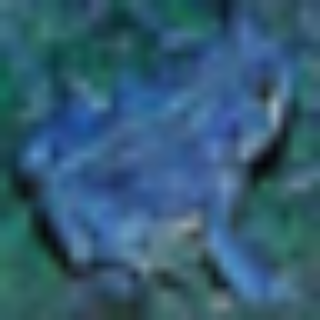

discriminator loss: 0.6943463683128357
generator loss: 0.7606180906295776
Generated image (step 6700)


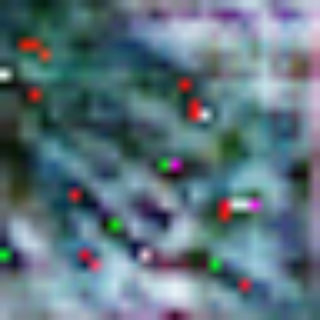

Real image (step 6700)


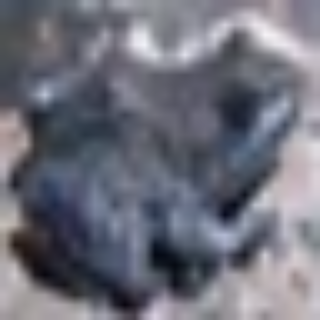

discriminator loss: 0.6870060563087463
generator loss: 0.7206739187240601
Generated image (step 6800)


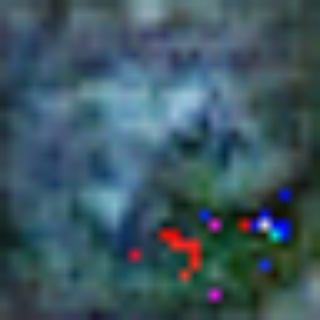

Real image (step 6800)


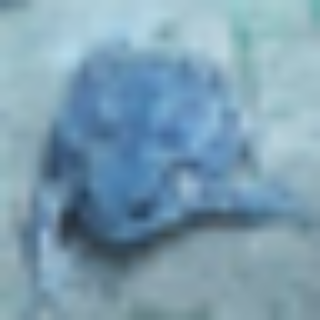

discriminator loss: 0.697213351726532
generator loss: 0.7139933109283447
Generated image (step 6900)


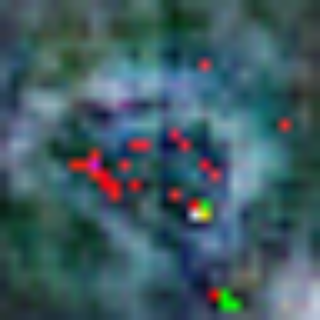

Real image (step 6900)


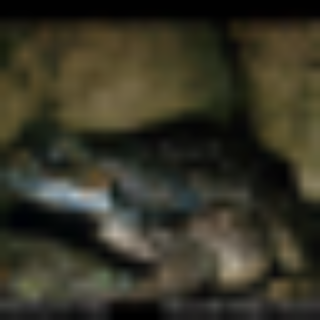

discriminator loss: 0.6907662153244019
generator loss: 0.8124181628227234
Generated image (step 7000)


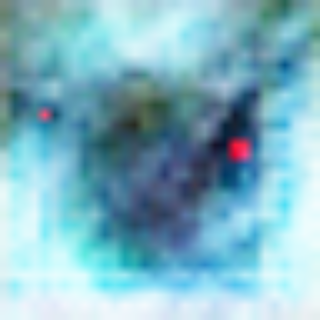

Real image (step 7000)


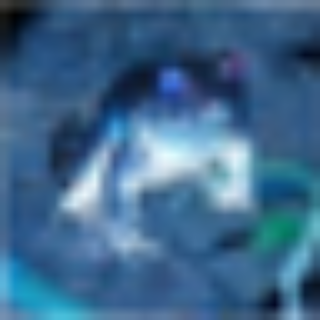

discriminator loss: 0.694017767906189
generator loss: 0.7280923128128052
Generated image (step 7100)


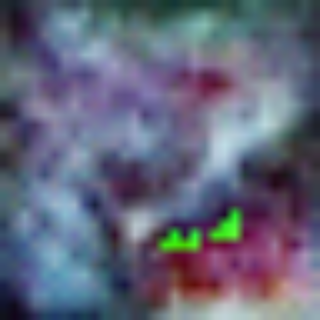

Real image (step 7100)


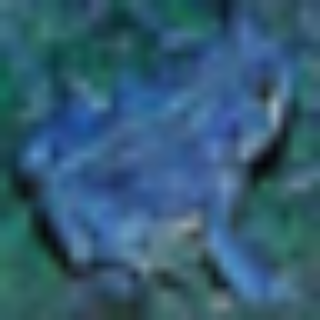

discriminator loss: 0.7019150853157043
generator loss: 0.7491379380226135
Generated image (step 7200)


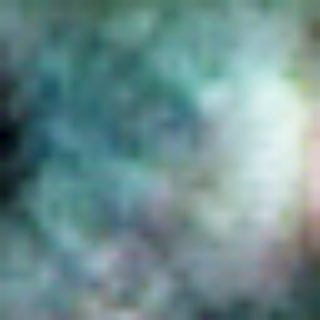

Real image (step 7200)


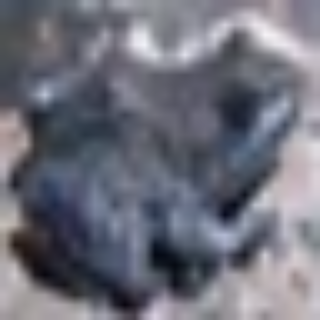

discriminator loss: 0.698763906955719
generator loss: 0.8271797895431519
Generated image (step 7300)


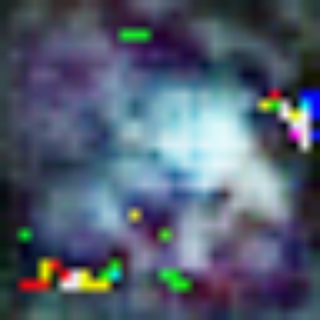

Real image (step 7300)


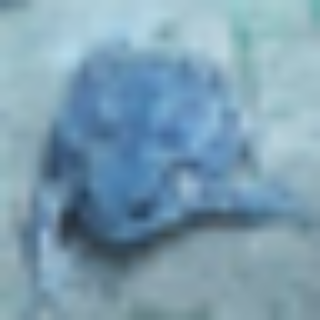

discriminator loss: 0.6913439631462097
generator loss: 0.7688350677490234
Generated image (step 7400)


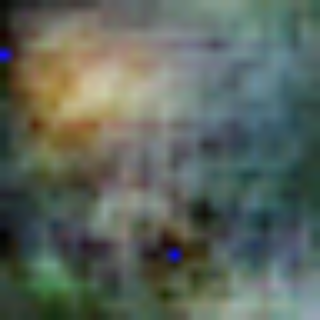

Real image (step 7400)


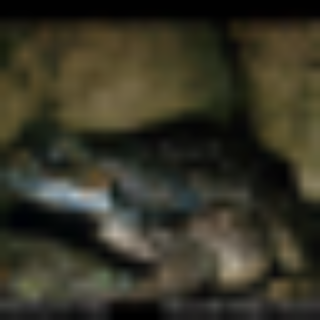

discriminator loss: 0.7181809544563293
generator loss: 0.7357348203659058
Generated image (step 7500)


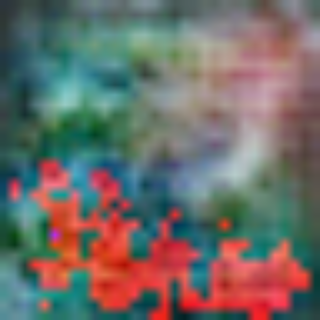

Real image (step 7500)


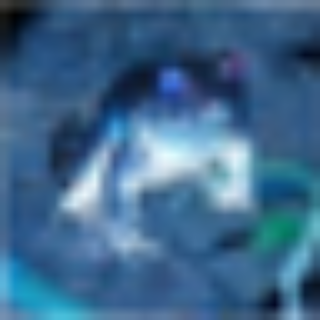

discriminator loss: 0.6935562491416931
generator loss: 0.7521518468856812
Generated image (step 7600)


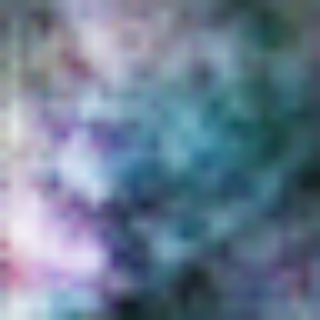

Real image (step 7600)


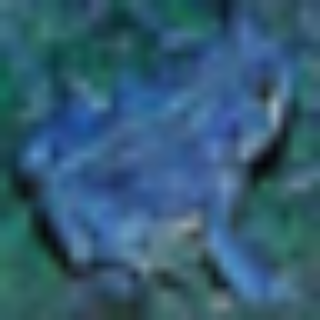

discriminator loss: 0.6763860583305359
generator loss: 0.7473320960998535
Generated image (step 7700)


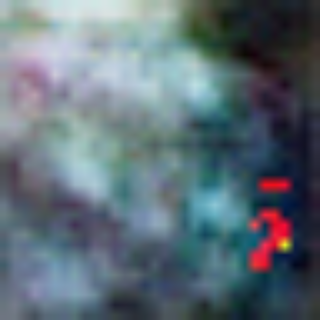

Real image (step 7700)


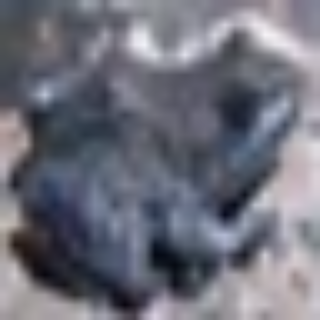

discriminator loss: 0.6866012811660767
generator loss: 0.716637909412384
Generated image (step 7800)


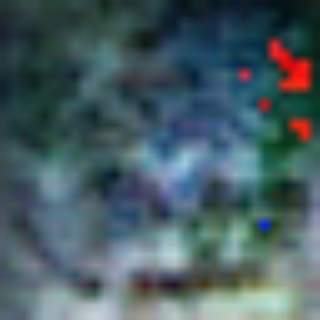

Real image (step 7800)


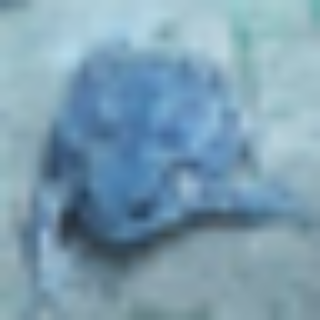

discriminator loss: 0.7018311023712158
generator loss: 0.7810048460960388
Generated image (step 7900)


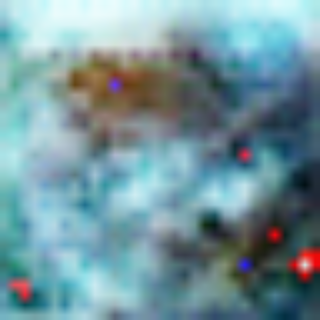

Real image (step 7900)


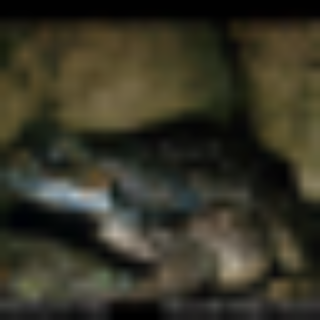

discriminator loss: 0.6742113828659058
generator loss: 0.7469444870948792
Generated image (step 8000)


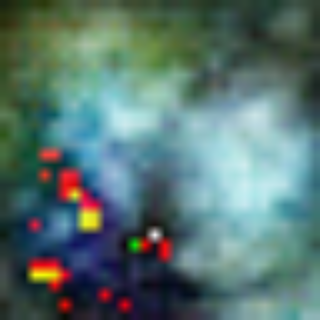

Real image (step 8000)


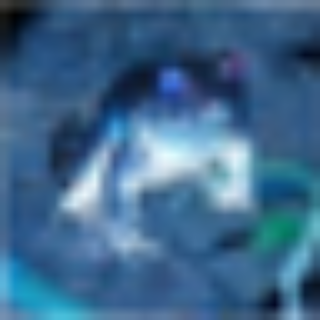

discriminator loss: 0.682303786277771
generator loss: 0.6839464902877808
Generated image (step 8100)


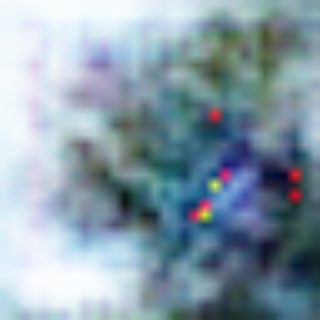

Real image (step 8100)


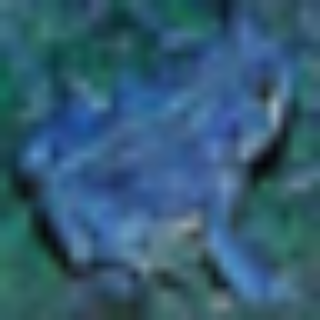

discriminator loss: 0.6964510679244995
generator loss: 0.7629178166389465
Generated image (step 8200)


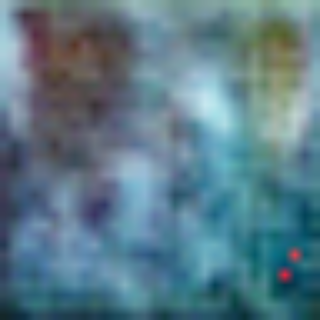

Real image (step 8200)


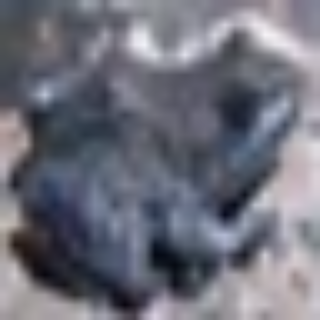

discriminator loss: 0.6974047422409058
generator loss: 0.726019024848938
Generated image (step 8300)


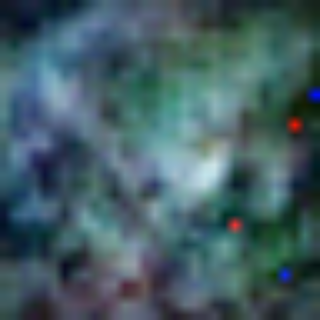

Real image (step 8300)


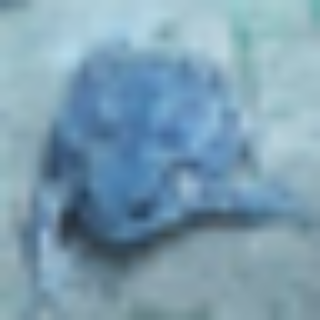

discriminator loss: 0.7076717615127563
generator loss: 0.7563773393630981
Generated image (step 8400)


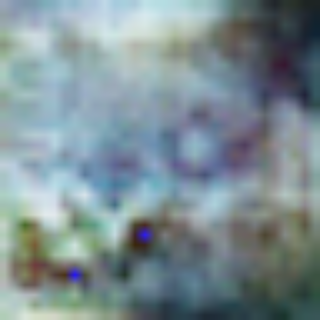

Real image (step 8400)


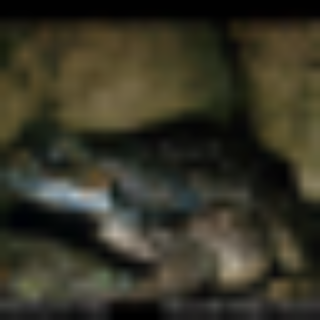

discriminator loss: 0.7154150605201721
generator loss: 0.8465255498886108
Generated image (step 8500)


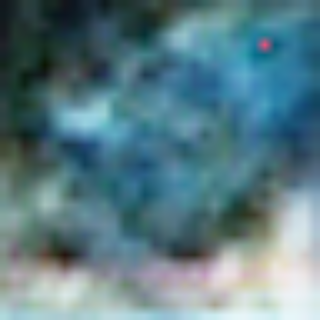

Real image (step 8500)


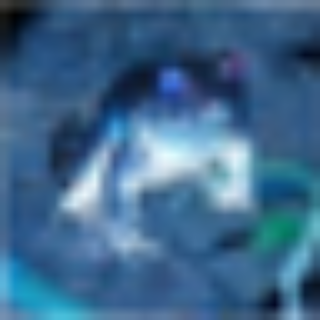

discriminator loss: 0.7008147239685059
generator loss: 0.7551471590995789
Generated image (step 8600)


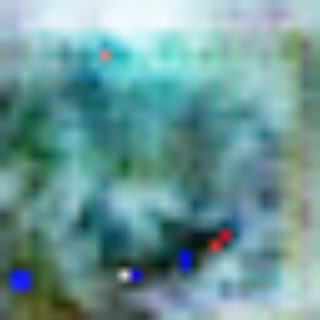

Real image (step 8600)


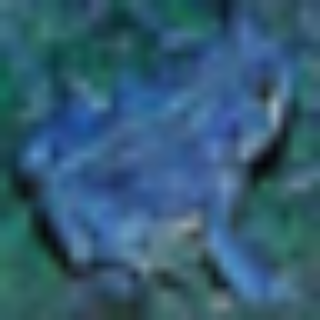

discriminator loss: 0.6925922632217407
generator loss: 0.741968035697937
Generated image (step 8700)


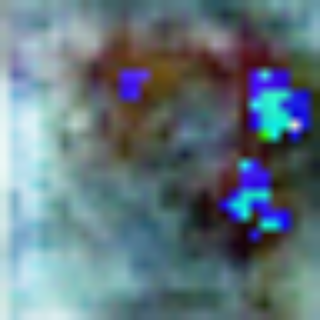

Real image (step 8700)


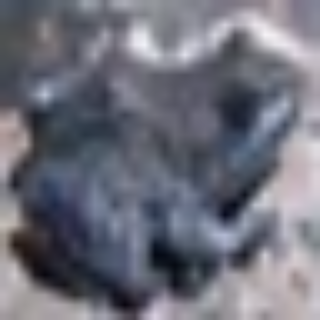

discriminator loss: 0.6976500749588013
generator loss: 0.7399870157241821
Generated image (step 8800)


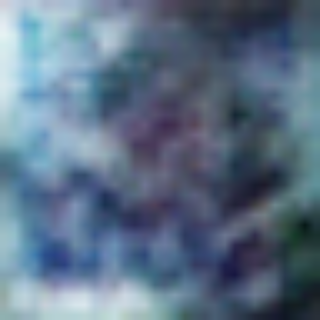

Real image (step 8800)


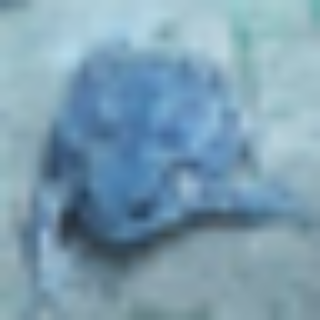

discriminator loss: 0.7261356711387634
generator loss: 0.7142181992530823
Generated image (step 8900)


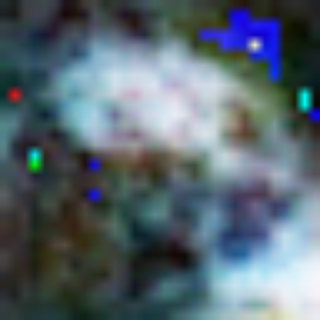

Real image (step 8900)


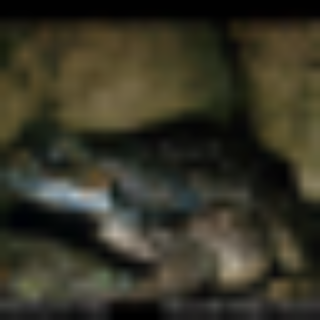

discriminator loss: 0.6855574250221252
generator loss: 0.7211975455284119
Generated image (step 9000)


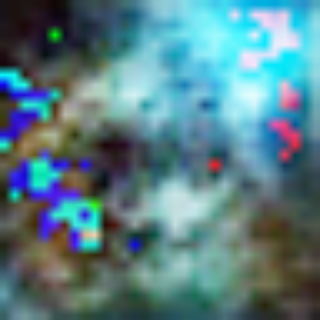

Real image (step 9000)


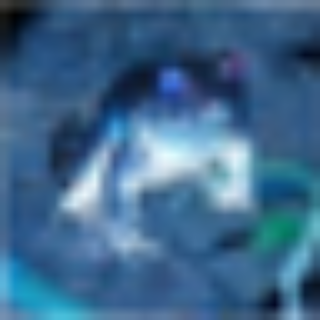

discriminator loss: 0.6921359896659851
generator loss: 0.7284212112426758
Generated image (step 9100)


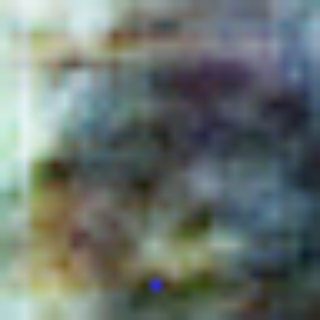

Real image (step 9100)


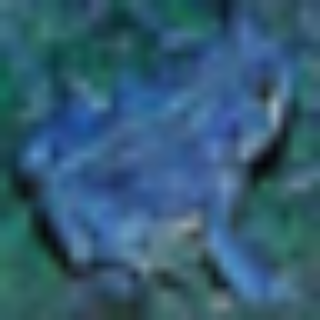

discriminator loss: 0.6972058415412903
generator loss: 0.7283260226249695
Generated image (step 9200)


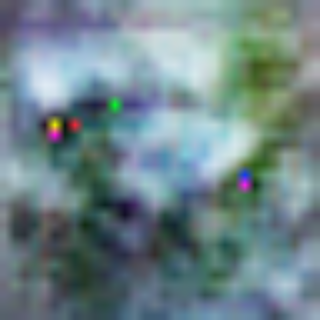

Real image (step 9200)


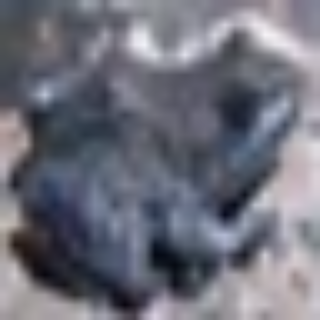

discriminator loss: 0.8148948550224304
generator loss: 0.7911982536315918
Generated image (step 9300)


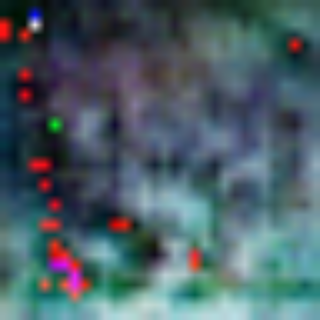

Real image (step 9300)


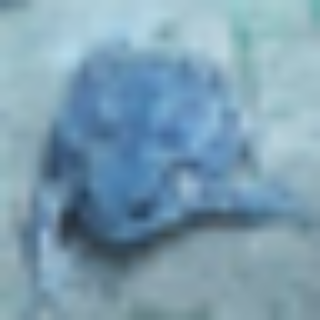

discriminator loss: 0.6930817365646362
generator loss: 0.6581541299819946
Generated image (step 9400)


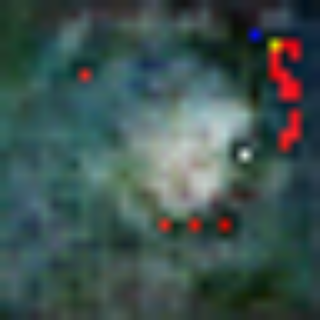

Real image (step 9400)


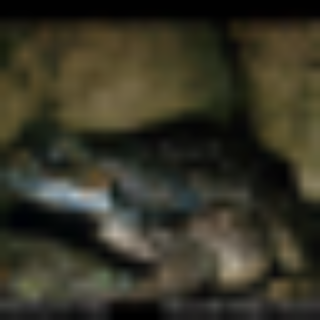

discriminator loss: 0.6837210655212402
generator loss: 0.7278314828872681
Generated image (step 9500)


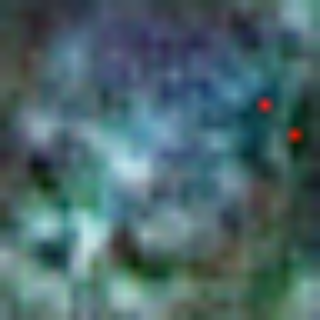

Real image (step 9500)


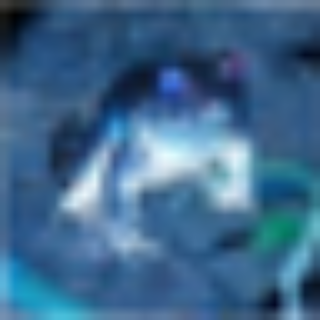

discriminator loss: 0.6903643608093262
generator loss: 0.7616603970527649
Generated image (step 9600)


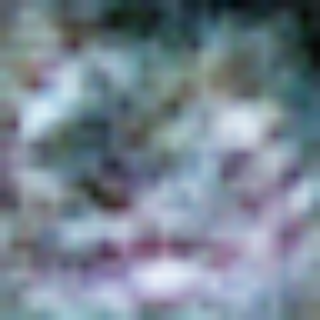

Real image (step 9600)


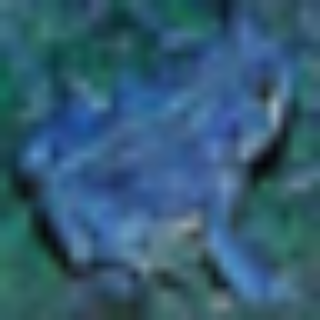

discriminator loss: 0.6975070238113403
generator loss: 0.7655738592147827
Generated image (step 9700)


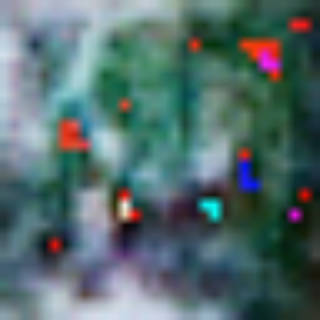

Real image (step 9700)


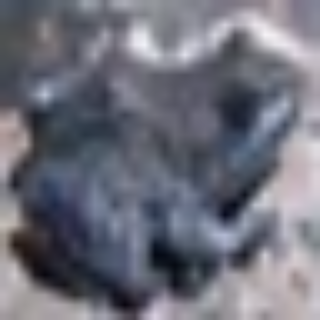

discriminator loss: 0.7118706107139587
generator loss: 0.8732399940490723
Generated image (step 9800)


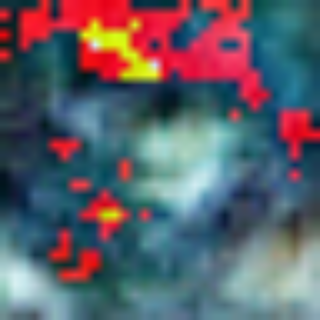

Real image (step 9800)


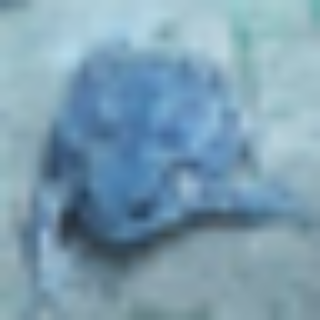

discriminator loss: 0.6935667991638184
generator loss: 0.7142580151557922
Generated image (step 9900)


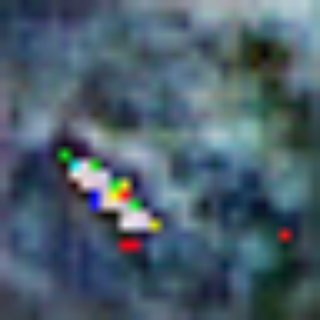

Real image (step 9900)


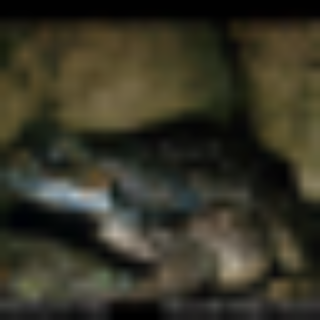

In [ ]:
import os
import cv2
from keras.preprocessing import image
from google.colab.patches import cv2_imshow

(x_train, y_train), (_, _) = keras.datasets.cifar10.load_data()

# выбор только лягушек
x_train = x_train[y_train.flatten() == 6]

# нормализация данных
x_train = x_train.reshape((x_train.shape[0],) + (height, width, channels)).astype('float32') / 255.

# гиперпараметры
batch_size = 20
iterations = 10_000

# папка для сохранения сгенерированных фото
save_dir = '/content/drive/MyDrive/StudyingKeras/GAN/images_from_GAN'

start = 0
for step in range(iterations):
  # выборка случайных точек из пространства представлений
  random_vectors = np.random.normal(size=(batch_size, dimensions))
  # декодирование точек в изображения
  generated_images = generator.predict(random_vectors)

  # объединение настоящих и сгенерированных изображений
  stop = start+batch_size
  real_images = x_train[start: stop]
  combined_images = np.concatenate([generated_images, real_images])

  # метки, отличающие настоящие изображения от поддельных
  labels = np.concatenate([np.ones((batch_size,1)), np.zeros((batch_size, 1))])
  # добавление случайного шума в метки - важная хитрость, как и добавление прореживания 
  # в дискриминатор ранее
  labels += 0.05 * np.random.random(labels.shape)

  # обучение дискриминатора на части данных
  d_loss = discriminator.train_on_batch(combined_images, labels)

  # повторный выбор случайных точек из пространства представлений
  random_vectors = np.random.normal(size=(batch_size, dimensions))

  # ложные метки, которые всегда говорят "настоящее"
  misleading_labels = np.zeros((batch_size, 1))
  # обучение генератора (через gan, которая замораживает дискриминатор)
  g_loss = gan.train_on_batch(random_vectors, misleading_labels)

  start += batch_size
  if start > len(x_train) - batch_size:
    start = 0
  
  # каждые 100 шагов сохраняем изображение
  if step % 100 == 0:
    gan.save_weights('/content/drive/MyDrive/StudyingKeras/GAN/weights/gan.h5')

    print(f'discriminator loss: {d_loss}')
    print(f'generator loss: {g_loss}')

    # сохранение и вывод сгенерированного изображения
    img = image.array_to_img(generated_images[0] * 255., scale=False)
    img.save(os.path.join(save_dir, f'generated_img_{step}.png'))
    img_to_show = image.img_to_array(img)
    img_to_show = cv2.resize(img_to_show, (320, 320))
    print(f'Generated image (step {step})')
    cv2_imshow(img_to_show)

    # сохранение и вывод настоящего изображения для сравнения
    img = image.array_to_img(real_images[0] * 255., scale=False)
    img.save(os.path.join(save_dir, f'REAL_img_{step}.png'))
    img_to_show = image.img_to_array(img)
    img_to_show = cv2.resize(img_to_show, (320, 320))
    print(f'Real image (step {step})')
    cv2_imshow(img_to_show)
  



В случае, если потери gan резко растут, а потери дискриминатора стремятся к нулю, стоит уменьшить скорость обучения дискриминатор и увеличить прореживание